### Font Classification: 
The task for this is to create a Font Classifier. The classifier should take a single image as input and return the name (or label) of the font used in the image from a predefined list of 10 fonts.
Fonts to Classify:
1.	Aguafina Script
2.	Alex Brush
3.	Allura
4.	Alsscrp
5.	Canterbury
6.	Great Vibes
7.	Holligate Signature
8.	I Love Glitter
9.	James Fajardo
10.	Open Sans

### Data Collection and Preparation:

For this task data folder provided contained example images of the crops that the model is expected to classify. To complete such a intensive computer vision task we would require a significatly large dataset.<br>
Hence resampling of data points is called for where we try to strech the current cropped example to create our dataset. To begin we try to find the maximum heigh and width of the croped samples we have and how<br>
many samples of each class do we have. To get an estimate of the samples how they can be useful in creating data.
 

In [1]:
from PIL import Image, ImageOps, ImageDraw, ImageFont
import os
import shutil
import random
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.models as models
import torchvision.transforms as transforms
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, random_split
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import precision_score, recall_score, f1_score
from sklearn.metrics import roc_curve, auc
from tabulate import tabulate


In [2]:


def get_image_dimensions(image_path):
    """Get the dimensions (width, height) of an image.

    Args:
        image_path (str): The path to the image file.
        
    Returns:
        tuple: A tuple containing the width and height of the image.
    """
    with Image.open(image_path) as img:
        return img.size

def get_max_min_dimensions(folder_path):
    """Get the maximum and minimum dimensions of images in a folder.
    
    Args:
        folder_path (str): The path to the folder containing the images.
        
    Returns:
        tuple: A tuple containing two tuples, each representing the minimum and maximum dimensions 
               (width, height) of the images in the folder.
    """
    max_width = max_height = float('-inf')
    min_width = min_height = float('inf') 
    dir_c = 0
    for root, dirs, files in os.walk(folder_path):
        counts = 0
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                image_path = os.path.join(root, file)
                width, height = get_image_dimensions(image_path)
                
                max_width = max(max_width, width)
                max_height = max(max_height, height)
                min_width = min(min_width, width)
                min_height = min(min_height, height)
            counts+=1
        if files:
            print("font type: %s number of samples: %d" % (root, counts))
    
    return (min_width, min_height), (max_width, max_height)

folder_path = "data"
min_dimensions, max_dimensions = get_max_min_dimensions(folder_path)
print("\nThe width of a image lies : %d to %d" % (max_dimensions[0],  min_dimensions[0]))
print("The height of a image lies : %d to %d" % (max_dimensions[1],  min_dimensions[1]))

font type: data/AguafinaScript number of samples: 83
font type: data/AlexBrush number of samples: 78
font type: data/Allura number of samples: 70
font type: data/alsscrp number of samples: 102
font type: data/Canterbury number of samples: 76
font type: data/GreatVibes number of samples: 76
font type: data/Holligate Signature number of samples: 82
font type: data/I Love Glitter number of samples: 72
font type: data/James Fajardo number of samples: 80
font type: data/OpenSans number of samples: 73

The width of a image lies : 2542 to 78
The height of a image lies : 121 to 44


#### 1) Datapoint Extracting Technique

Now we know that the number of samples required are far too low to train any model if we use the images in the form they are, to remedy this problem we use the technique stated in Tensmeyer et al [1] where we<br>
divide each example cropped image in data into patches of dimension 128 X 128 at a stride of 28 pixels using the 'divide_into_patches' method to create data-points for the model for each class as explained in figure 1. <br> <br>
<center>
<img src="Figure_1.PNG">
<br> Figure 1 : Showing data collections from examples in data. 
</center>
<br>


In [3]:
def divide_into_patches(image_path, output_folder):
    """Divide an image into patches of size 128x128 pixels with a stride of 28 pixels.
    
    Args:
        image_path (str): The path to the input image file.
        output_folder (str): The path to the output folder where patches will be saved.
    """
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    image = Image.open(image_path)
    width, height = image.size
    
    # Pad the image if smaller than 128x128
    if width < 128 or height < 128:
        pad_width = max(0, 128 - width)
        pad_height = max(0, 128 - height)
        padding = (pad_width // 2, pad_height // 2, (pad_width + 1) // 2, (pad_height + 1) // 2)
        image = ImageOps.expand(image, padding, fill='white')

    # Divide into patches
    stride = 28
    patch_size = 128
    patch_id = 0
    width, height = image.size
    for y in range(0, height - patch_size + 1, stride):
        for x in range(0, width - patch_size + 1, stride):
            box = (x, y, x + patch_size, y + patch_size)
            patch = image.crop(box)
            patch.save(os.path.join(output_folder, f"{os.path.splitext(os.path.basename(image_path))[0]}_{patch_id}.jpg"))
            patch_id += 1


In [4]:
def get_image_paths(folder_path):
    """Get a list of image paths in the specified folder.
    
    Args:
        folder_path (str): The path to the folder containing images.
        
    Returns:
        list: A list of image paths.
    """
    image_paths = []

    # Iterate through all files in the folder
    for filename in os.listdir(folder_path):
        image_path = os.path.join(folder_path, filename)
        # Append the image path to the list
        image_paths.append(image_path)

    return image_paths


#### 2) Datapoint Extraction and Test Separation
To make sure the model doesn't overfit or doesn't perform as intended we will septate out 15% of each class example of cropped images for further testing in a 'test' dataset and with the remaining we will create<br>
datapoints out of the rest by patching and storing them in 'Data_train' dataset for train, test and validation. 

In [5]:

# Example usage
font_type = ['AguafinaScript', 'AlexBrush', 'Allura', 'alsscrp', 'Canterbury', 'GreatVibes', 'Holligate Signature', 'I Love Glitter', 'James Fajardo', 'OpenSans']

for i in range(len(font_type)):
    output_folder = "Data_train/"+font_type[i]
    test_output_folder = "test/"+font_type[i]
    folder_path = 'data/'+font_type[i]

    image_paths = get_image_paths(folder_path)
    # Number of test samples to be removed each class
    test_num = int(0.15 * len(image_paths))
    test_image_path = image_paths[-test_num:]
    # Data extraction for each class
    for img in image_paths[:len(image_paths)-test_num]:
        divide_into_patches(img, output_folder)

    # Saving test images in a separated directory
    for img in test_image_path:
        if not os.path.exists(test_output_folder):
            os.makedirs(test_output_folder)
        shutil.copy(img, test_output_folder)

#### 3) Data Imbalance
Form the code below it shows the number of datapoints extracted from each sample of crop example provided for each class. We conclude the that all the classes are imbalanced to remedy this we practice synthetic data<br> 
generation to create new data points for all classes.

In [6]:
class_size = dict()
# To show the number of datapoints in class in Data_train dataset
for i in range(len(font_type)):
    output_folder = "Data_train/"+font_type[i]
    images = len(get_image_paths(output_folder))
    class_size[font_type[i]] = images
    print("Count in %s: %d" % (output_folder, images))
print("\n\n")

# To show the number of datapoints in each class in test dataset
for i in range(len(font_type)):
    output_folder = "test/"+font_type[i]
    images = len(get_image_paths(output_folder))
    print("Test dataset Count in %s: %d" % (output_folder, images))

Count in Data_train/AguafinaScript: 1162
Count in Data_train/AlexBrush: 1418
Count in Data_train/Allura: 1270
Count in Data_train/alsscrp: 1862
Count in Data_train/Canterbury: 1457
Count in Data_train/GreatVibes: 1159
Count in Data_train/Holligate Signature: 1620
Count in Data_train/I Love Glitter: 1215
Count in Data_train/James Fajardo: 793
Count in Data_train/OpenSans: 1985



Test dataset Count in test/AguafinaScript: 12
Test dataset Count in test/AlexBrush: 11
Test dataset Count in test/Allura: 10
Test dataset Count in test/alsscrp: 15
Test dataset Count in test/Canterbury: 11
Test dataset Count in test/GreatVibes: 11
Test dataset Count in test/Holligate Signature: 12
Test dataset Count in test/I Love Glitter: 10
Test dataset Count in test/James Fajardo: 12
Test dataset Count in test/OpenSans: 10


As font data is uniform in the sense of style each character is represented only thing that differentiates a datapoint is the size of the text and the words on it making it easier to replicate.

In [7]:
def generate_font_images(font_path, output_folder, font_type, num_images=800, min_font_size=20, max_font_size=60, image_size=(128, 128)):
    """Generate and save font images using a specified font the content of font images are random including the size of the font.
    
    Args:
        font_path (str): The path to the font file.
        output_folder (str): The path to the folder where images will be saved.
        font_type (str): The type or name of the font.
        num_images (int, optional): The number of images to generate. Defaults to 800.
        min_font_size (int, optional): The minimum font size for the generated images. Defaults to 20.
        max_font_size (int, optional): The maximum font size for the generated images. Defaults to 60.
        image_size (tuple, optional): The size of the generated images in pixels (width, height). Defaults to (128, 128).
    """
    # Create output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Load the font
    font = ImageFont.truetype(font_path, min_font_size)

    # Generate and save font images
    for i in range(num_images):
        # Generate random word
        word_length = random.randint(5, 20)  # Random text length between 5 and 20 characters
        word = ''.join(random.choices('abcdefghijklmnopqrstuvwxy zABCDEFGHI,.:\';" JKLMNOPQRSTUVWXYZ0 123456789', k=word_length))

        # Choose random font size
        font_size = random.randint(min_font_size, max_font_size)
        font = ImageFont.truetype(font_path, font_size)

        # Create a new image with white background
        image = Image.new("RGB", image_size, (255, 255, 255))

        # Draw text on the image
        draw = ImageDraw.Draw(image)
        text_width, text_height = draw.textsize(word, font=font)

        # Wrap text if it exceeds image width
        if text_width > image_size[0]:
            lines = []
            line = ''
            for char in word:
                char_width, _ = draw.textsize(char, font=font)
                if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
                    line += char
                else:
                    lines.append(line)
                    line = char
            lines.append(line)
            word = '\n'.join(lines)

        text_width, text_height = draw.textsize(word, font=font)
        text_position = ((image_size[0] - text_width) // 2, (image_size[1] - text_height) // 2)
        draw.multiline_text(text_position, word, fill=(0, 0, 0), font=font, align="center")

        # Save the image
        image_filename = font_type + f"_f{i}.png"
        image.save(os.path.join(output_folder, image_filename))
    print("Generation complete!")


In [8]:
font_list = ['fonts/AguafinaScript.ttf', 'fonts/AlexBrush.ttf', 'fonts/Allura.ttf', 'fonts/alsscrp.ttf', 'fonts/Canterbury.ttf', 'fonts/GreatVibes.ttf', 'fonts/Holligate Signature.ttf', 'fonts/I Love Glitter.ttf', 'fonts/James Fajardo.ttf', 'fonts/OpenSans.ttf']
for i in range(len(font_type)):
    output_folder = "Data_train/"+font_type[i]
    img_count = 2000 - class_size[font_type[i]]
    generate_font_images(font_list[i], output_folder, font_type[i], num_images= img_count)

/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 1

Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 1

Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 1

Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:51: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:51: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in

Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 1

Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 1

Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 1

Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 1

Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:51: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10

Generation complete!
Generation complete!


/tmp/ipykernel_30233/1212321530.py:35: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  text_width, text_height = draw.textsize(word, font=font)
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  if char_width + draw.textsize(line, font=font)[0] <= image_size[0]:
/tmp/ipykernel_30233/1212321530.py:42: DeprecationWarning: textsize is deprecated and will be removed in Pillow 10 (2023-07-01). Use textbbox or textlength instead.
  char_width, _ = draw.textsize(char, font=font)
/tmp/ipykernel_30233/1212321530.py:43: DeprecationWarning: textsize is deprecated and will be removed in Pillow 1

#### 4) Data Balance
By generating ample synthetic data points all classes are now balanced with 2000 datapoints in each class.

In [9]:
# To show the number of datapoints in class in Data_train dataset
for i in range(len(font_type)):
    output_folder = "Data_train/"+font_type[i]
    images = len(get_image_paths(output_folder))
    class_size[font_type[i]] = images
    print("Count in %s: %d" % (output_folder, images))
print("\n\n")

Count in Data_train/AguafinaScript: 2000
Count in Data_train/AlexBrush: 2000
Count in Data_train/Allura: 2000
Count in Data_train/alsscrp: 2000
Count in Data_train/Canterbury: 2000
Count in Data_train/GreatVibes: 2000
Count in Data_train/Holligate Signature: 2000
Count in Data_train/I Love Glitter: 2000
Count in Data_train/James Fajardo: 2000
Count in Data_train/OpenSans: 2000





### Model Development

For the application of studying patterns in image data for classification of font Convolutional Neural Networks come to mind. From the study of Tensmeyer et al 2017 [1] and Mohammadian et al 2023 [2] in font<br>
classification Res-Net architecture seems like the most viable options. ResNet allows for the training of very deep neural networks, even exceeding 100 layers. Deeper networks have the potential to capture more<br>
complex patterns and hierarchical features in images, leading to better performance in image classification tasks. The Residual connections, which are introduced in ResNet, help to mitigate the vanishing gradient<br>
problem. By allowing the gradient to bypass some layers, the network can propagate information more effectively during training, enabling the training of deeper networks without suffering from degradation in<br>
performance. It also consists of pooling layers reduce the spatial dimensions (width and height) of the input feature maps while preserving important features. This reduction in dimensionality reduces the<br>
computational cost of subsequent layers and helps in controlling overfitting by reducing the model's parameter count.

For this application we data augmentation to prevent overfitting by random rotation, random horizontal flips and Vertical flips. Also in the fully connected layer we add an extra layer dropout so it can generalize<br>
better even if all features are not there.

We make use of a pretrained resnet for the task as studies show evidence of better performance by using a pretrained model Sharif et al (2014)[3]

We the code below after the data is augmented we do a random split on the data into 15% test, 15% validation and 70% trainning set, we make use of SGD optimizer as it is computationally efficient and scales well to<br>
large datasets commonly encountered in image classification tasks and Cross entropy loss as it work we will classification problems.

We keep track of training accuracy, validation accuracy, training loss and validation loss at every epoch.
<center>
<img src="ResNet-18-Architecture.png">
<br> Figure 2 : ResNet-18 Architecture. 
</center>
<br>


In [10]:
# Define transformations
transform = transforms.Compose([
    transforms.RandomRotation(10),
    transforms.RandomHorizontalFlip(),
    transforms.RandomVerticalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Use ImageNet normalization
])

# Load the dataset
data_path = 'Data_train/'
dataset = datasets.ImageFolder(root=data_path, transform=transform)



Epoch [1/8], Train Loss: 0.7727, Train Acc: 74.00%, Val Loss: 0.1958, Val Acc: 92.57%
Epoch [2/8], Train Loss: 0.1899, Train Acc: 93.66%, Val Loss: 0.1259, Val Acc: 95.43%
Epoch [3/8], Train Loss: 0.1323, Train Acc: 95.74%, Val Loss: 0.0697, Val Acc: 97.70%
Epoch [4/8], Train Loss: 0.0934, Train Acc: 96.94%, Val Loss: 0.0603, Val Acc: 97.87%
Epoch [5/8], Train Loss: 0.0784, Train Acc: 97.44%, Val Loss: 0.0363, Val Acc: 98.77%
Epoch [6/8], Train Loss: 0.0596, Train Acc: 98.01%, Val Loss: 0.0392, Val Acc: 98.80%
Epoch [7/8], Train Loss: 0.0521, Train Acc: 98.33%, Val Loss: 0.0327, Val Acc: 98.87%
Epoch [8/8], Train Loss: 0.0515, Train Acc: 98.35%, Val Loss: 0.0413, Val Acc: 98.57%


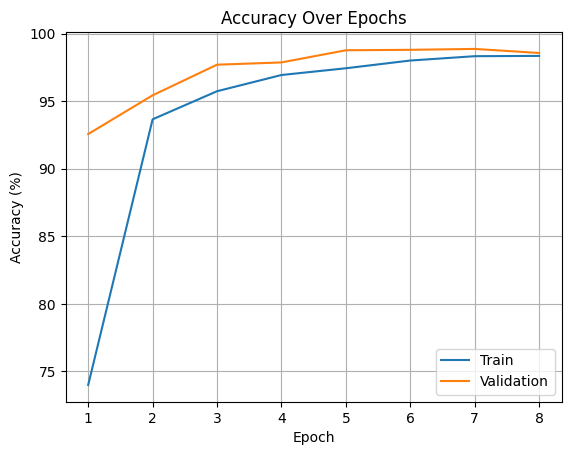

In [11]:
# Split dataset into training, validation, and test sets
train_size = int(0.7 * len(dataset))
val_size = int(0.15 * len(dataset))
test_size = len(dataset) - train_size - val_size
train_set, val_set, test_set = random_split(dataset, [train_size, val_size, test_size])

# Define data loaders
batch_size = 32
train_loader = DataLoader(train_set, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_set, batch_size=batch_size)
test_loader = DataLoader(test_set, batch_size=batch_size)

# Load pre-trained ResNet model
# resnet = models.resnet18(pretrained=True)
resnet = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)

# Modify the last layer for 10 classes
num_ftrs = resnet.fc.in_features
resnet.fc = nn.Sequential(
    nn.Linear(num_ftrs, 512),  # Add a new fully connected layer
    nn.ReLU(),  # Add ReLU activation function
    nn.Dropout(p=0.5),  # Add Dropout with a dropout probability of 0.5
    nn.Linear(512, 10)  # Output layer
)
resnet.to("cuda")
# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.SGD(resnet.parameters(), lr=0.001, momentum=0.9)

# Train the model
num_epochs = 8
train_accuracy = []
val_accuracy = []

for epoch in range(num_epochs):
    resnet.train()
    running_loss = 0.0
    correct = 0
    total = 0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to("cuda"), labels.to("cuda")
        optimizer.zero_grad()
        outputs = resnet(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        running_loss += loss.item()
        _, predicted = outputs.max(1)
        total += labels.size(0)
        correct += predicted.eq(labels).sum().item()

    train_loss = running_loss / len(train_loader)
    train_accuracy.append(100. * correct / total)
    train_acc = 100. * correct / total

    # Validate the model
    resnet.eval()
    val_loss = 0.0
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to("cuda"), labels.to("cuda")
            outputs = resnet(inputs)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = outputs.max(1)
            total += labels.size(0)
            correct += predicted.eq(labels).sum().item()

    val_loss /= len(val_loader)
    val_acc = 100. * correct / total
    val_accuracy.append(100. * correct / total)

    print(f'Epoch [{epoch+1}/{num_epochs}], '
          f'Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.2f}%, '
          f'Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.2f}%')

plt.plot(range(1, num_epochs + 1), train_accuracy, label='Train')
plt.plot(range(1, num_epochs + 1), val_accuracy, label='Validation')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')
plt.title('Accuracy Over Epochs')
plt.legend()
plt.grid(True)
plt.show()


### Evaluation Metrics
To evaluate the performace we make use of precision score, recall score, f1 score for each class. Precision measures the proportion of correctly classified font instances among all instances classified<br>
as that font. Recall measures the proportion of correctly classified font instances out of the total instances of that font class. The F1-score is the harmonic mean of precision and recall, providing a<br> 
balanced evaluation.

We also make use of  Receiver Operating Characteristic (ROC) curve and the Area Under the Curve (AUC) score can be useful for evaluating the performance of a classifier for each font class against all <br>
other classes. A high AUC score indicates that the classifier can effectively distinguish between the target font class and the rest.

Test Accuracy: 98.77%

Per-Class Metrics:
+---------------------+-------------+----------+------------+
| Class               |   Precision |   Recall |   F1 Score |
+=====================+=============+==========+============+
| AguafinaScript      |    1        | 1        |   1        |
+---------------------+-------------+----------+------------+
| AlexBrush           |    0.930314 | 0.988889 |   0.958707 |
+---------------------+-------------+----------+------------+
| Allura              |    0.990566 | 0.945946 |   0.967742 |
+---------------------+-------------+----------+------------+
| Canterbury          |    1        | 0.99635  |   0.998172 |
+---------------------+-------------+----------+------------+
| GreatVibes          |    0.980519 | 0.977346 |   0.97893  |
+---------------------+-------------+----------+------------+
| Holligate Signature |    0.996997 | 1        |   0.998496 |
+---------------------+-------------+----------+------------+
| I Love Glitter      |    0

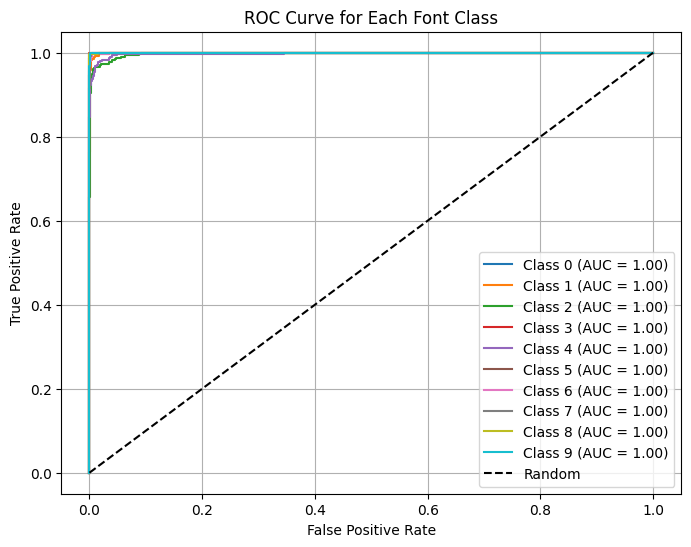


AUC Score for Each Class:
+---------------------------+-------------+
| Class                     |   AUC Score |
+===========================+=============+
| Class AguafinaScript      |    0.999973 |
+---------------------------+-------------+
| Class AlexBrush           |    0.999531 |
+---------------------------+-------------+
| Class Allura              |    0.998013 |
+---------------------------+-------------+
| Class Canterbury          |    1        |
+---------------------------+-------------+
| Class GreatVibes          |    0.997739 |
+---------------------------+-------------+
| Class Holligate Signature |    0.999955 |
+---------------------------+-------------+
| Class I Love Glitter      |    0.999814 |
+---------------------------+-------------+
| Class James Fajardo       |    0.999884 |
+---------------------------+-------------+
| Class OpenSans            |    0.999951 |
+---------------------------+-------------+
| Class alsscrp             |    0.99998  |
+----

In [12]:
# Initialize lists to store per-class metrics
precision_per_class = []
recall_per_class = []
f1_score_per_class = []

# Test the model
resnet.eval()
test_correct = 0
test_total = 0
predictions_all = []
labels_all = []

prediction_probabilities_all = []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to("cuda"), labels.to("cuda")
        outputs = resnet(inputs)
        _, predicted = outputs.max(1)
        test_total += labels.size(0)
        test_correct += predicted.eq(labels).sum().item()
        predictions_all.extend(predicted.cpu().numpy())
        labels_all.extend(labels.cpu().numpy())
        prediction_probabilities_all.extend(outputs.cpu().numpy())

test_acc = 100. * test_correct / test_total
print(f'Test Accuracy: {test_acc:.2f}%')

precision_per_class = precision_score(labels_all, predictions_all, average=None)
recall_per_class = recall_score(labels_all, predictions_all, average=None)
f1_score_per_class = f1_score(labels_all, predictions_all, average=None)

font_class = {0:'AguafinaScript', 1:'AlexBrush', 2:'Allura', 3:'Canterbury', 4:'GreatVibes', 5:'Holligate Signature', 6:'I Love Glitter', 7:'James Fajardo', 8:'OpenSans', 9:'alsscrp'}

class_metrics = []
for i in range(len(precision_per_class)):
    class_metrics.append([font_class[i], precision_per_class[i], recall_per_class[i], f1_score_per_class[i]])

print("\nPer-Class Metrics:")
print(tabulate(class_metrics, headers=["Class", "Precision", "Recall", "F1 Score"], tablefmt="grid"))

fpr_dict = {}
tpr_dict = {}
roc_auc_dict = {}

for class_index in range(10):
    binary_labels = [1 if label == class_index else 0 for label in labels_all]
    prediction_probabilities_class = [output[class_index].item() for output, label in zip(prediction_probabilities_all, labels_all)]
    fpr, tpr, _ = roc_curve(binary_labels, prediction_probabilities_class)
    roc_auc = auc(fpr, tpr)
    fpr_dict[class_index] = fpr
    tpr_dict[class_index] = tpr
    roc_auc_dict[class_index] = roc_auc

# Plot ROC curves for each class
plt.figure(figsize=(8, 6))
for class_index in range(10):
    plt.plot(fpr_dict[class_index], tpr_dict[class_index], label=f'Class {class_index} (AUC = {roc_auc_dict[class_index]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Each Font Class')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

# Print AUC score for each class
auc_scores = [[f'Class {font_class[class_index]}', roc_auc_dict[class_index]] for class_index in range(10)]
print("\nAUC Score for Each Class:")
print(tabulate(auc_scores, headers=["Class", "AUC Score"], tablefmt="grid"))

### Result
The model was trained successfully on all classes doesn't show signs of overfitting presents a execellent accuracy rate of 99.20%, almost 97-99% precision and recall on all classes. Model path is saved as shown below.

In [13]:
# model_path = 'final_font_class_10_model.pth'
# torch.save(resnet.state_dict(), model_path)


### Model Evaluation on Test samples
We are now going to evaluate the models accuracy rate, precision and recall on all classes, on the separated cropped examples provided stored in the test dataset to verify that models works as intended.

Accuracy on unseen dataset: 1.00

Per-Class Metrics:
+---------------------+-------------+----------+------------+
| Class               |   Precision |   Recall |   F1 Score |
+=====================+=============+==========+============+
| AguafinaScript      |    1        | 1        |   1        |
+---------------------+-------------+----------+------------+
| AlexBrush           |    0.916667 | 1        |   0.956522 |
+---------------------+-------------+----------+------------+
| Allura              |    1        | 1        |   1        |
+---------------------+-------------+----------+------------+
| Canterbury          |    1        | 1        |   1        |
+---------------------+-------------+----------+------------+
| GreatVibes          |    1        | 1        |   1        |
+---------------------+-------------+----------+------------+
| Holligate Signature |    1        | 1        |   1        |
+---------------------+-------------+----------+------------+
| I Love Glitter 

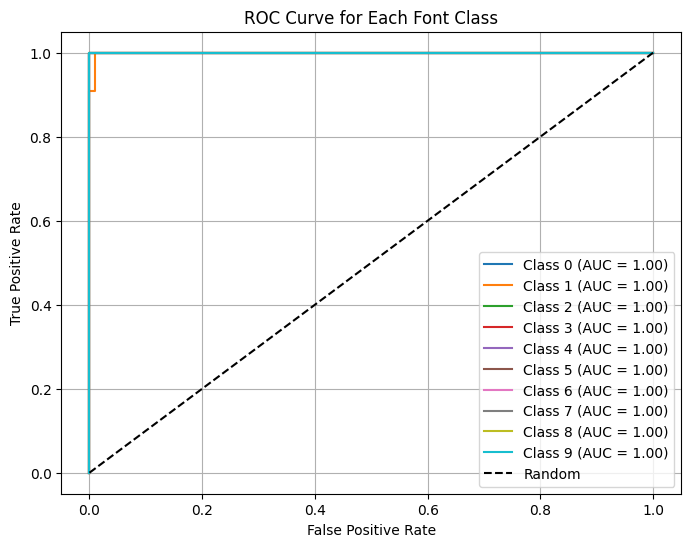


AUC Score for Each Class:
+---------------------------+-------------+
| Class                     |   AUC Score |
+===========================+=============+
| Class AguafinaScript      |    1        |
+---------------------------+-------------+
| Class AlexBrush           |    0.999117 |
+---------------------------+-------------+
| Class Allura              |    1        |
+---------------------------+-------------+
| Class Canterbury          |    1        |
+---------------------------+-------------+
| Class GreatVibes          |    1        |
+---------------------------+-------------+
| Class Holligate Signature |    1        |
+---------------------------+-------------+
| Class I Love Glitter      |    1        |
+---------------------------+-------------+
| Class James Fajardo       |    1        |
+---------------------------+-------------+
| Class OpenSans            |    1        |
+---------------------------+-------------+
| Class alsscrp             |    1        |
+----

In [14]:
font_class = {0:'AguafinaScript', 1:'AlexBrush', 2:'Allura', 3:'Canterbury', 4:'GreatVibes', 5:'Holligate Signature', 6:'I Love Glitter', 7:'James Fajardo', 8:'OpenSans', 9:'alsscrp'}
# Define a function to split image into patches
def split_image_into_patches(image, patch_size):
    width, height = image.size

    # Pad the image if smaller than 128x128
    if width < 128 or height < 128:
        pad_width = max(0, 128 - width)
        pad_height = max(0, 128 - height)
        padding = (pad_width // 2, pad_height // 2, (pad_width + 1) // 2, (pad_height + 1) // 2)
        image = ImageOps.expand(image, padding, fill='white')

    # Ensure RGB image
    image = image.convert('RGB')
    
    # Divide into patches
    stride = 28
    patch_size = 128
    patches = []
    width, height = image.size
    for y in range(0, height - patch_size + 1, stride):
        for x in range(0, width - patch_size + 1, stride):
            box = (x, y, x + patch_size, y + patch_size)
            patch = image.crop(box)
            patches.append(patch)
    return patches

# Define a function to get majority prediction from a list of predictions
def get_majority_prediction(predictions):
    unique, counts = np.unique(predictions, return_counts=True)
    majority_label = unique[np.argmax(counts)]
    return majority_label

# Define transformation for resizing and normalization
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

transform_to = transforms.Compose([
    transforms.ToTensor(),
])

# Load the unseen dataset
unseen_data_path = 'test/'
unseen_dataset = datasets.ImageFolder(root=unseen_data_path, transform=transform_to)  # Don't apply transformation here

# Create DataLoader for the unseen dataset
batch_size = 1  # Process one image at a time
unseen_loader = DataLoader(unseen_dataset, batch_size=batch_size, shuffle=False)

# Load pre-trained ResNet model
# resnet = models.resnet18(pretrained=True)
resnet = models.resnet18(weights=models.ResNet18_Weights.IMAGENET1K_V1)

# Modify the last layer for your specific number of classes
num_ftrs = resnet.fc.in_features
resnet.fc = nn.Sequential(
    nn.Linear(num_ftrs, 512),  # Add a new fully connected layer
    nn.ReLU(),  # Add ReLU activation function
    nn.Dropout(p=0.5),  # Add Dropout with a dropout probability of 0.5
    nn.Linear(512, 10)  # Output layer
)
resnet.cuda()

# Load the trained model state dict
model_path = 'final_font_class_10_model.pth'
resnet.load_state_dict(torch.load(model_path))

precision_per_class = []
recall_per_class = []
f1_score_per_class = []
# Set the model to evaluation mode
resnet.eval()

# Test the model on the unseen dataset
total_correct = 0
total_samples = 0
predictions_all = []
labels_all = []

prediction_probabilities_all = []

with torch.no_grad():
    for inputs, labels in unseen_loader:
        inputs, labels = inputs.cuda(), labels.cuda()  # Move data to GPU if available
        image = transforms.ToPILImage()(inputs.squeeze(0).cpu())  # Convert tensor back to PIL Image
        patches = split_image_into_patches(image, patch_size=128)
        patch_predictions = []
        for patch in patches:
            patch = transform(patch).unsqueeze(0).cuda()
            outputs = resnet(patch)
            _, predicted = torch.max(outputs, 1)
            patch_predictions.append(predicted.item())
        majority_prediction = get_majority_prediction(patch_predictions)
        total_samples += 1
        total_correct += (majority_prediction == labels.item())
        predictions_all.extend(predicted.cpu().numpy())
        labels_all.extend(labels.cpu().numpy())
        prediction_probabilities_all.extend(outputs.cpu().numpy())

# Calculate accuracy
accuracy = total_correct / total_samples
print(f'Accuracy on unseen dataset: {accuracy:.2f}')

precision_per_class = precision_score(labels_all, predictions_all, average=None)
recall_per_class = recall_score(labels_all, predictions_all, average=None)
f1_score_per_class = f1_score(labels_all, predictions_all, average=None)

# Print per-class metrics
class_metrics = []
for i in range(len(precision_per_class)):
    class_metrics.append([font_class[i], precision_per_class[i], recall_per_class[i], f1_score_per_class[i]])

print("\nPer-Class Metrics:")
print(tabulate(class_metrics, headers=["Class", "Precision", "Recall", "F1 Score"], tablefmt="grid"))

fpr_dict = {}
tpr_dict = {}
roc_auc_dict = {}

for class_index in range(10):
    binary_labels = [1 if label == class_index else 0 for label in labels_all]
    prediction_probabilities_class = [output[class_index].item() for output, label in zip(prediction_probabilities_all, labels_all)]
    fpr, tpr, _ = roc_curve(binary_labels, prediction_probabilities_class)
    roc_auc = auc(fpr, tpr)
    fpr_dict[class_index] = fpr
    tpr_dict[class_index] = tpr
    roc_auc_dict[class_index] = roc_auc

# Plot ROC curves for each class
plt.figure(figsize=(8, 6))
for class_index in range(10):
    plt.plot(fpr_dict[class_index], tpr_dict[class_index], label=f'Class {class_index} (AUC = {roc_auc_dict[class_index]:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Each Font Class')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

# Print AUC score for each class
auc_scores = [[f'Class {font_class[class_index]}', roc_auc_dict[class_index]] for class_index in range(10)]
print("\nAUC Score for Each Class:")
print(tabulate(auc_scores, headers=["Class", "AUC Score"], tablefmt="grid"))

### Result
The model was test successfully on all classes doesn't show signs of overfitting presents a execellent accuracy rate of 100% on un seen data, 100% precision and recall on all classes.

### Personal Evaluation
Below I have created a method to be used to make font predictions by suppling the path to a font sample image, I have created 'laymensample' by writing in open sans font on a word document<br>
and converting that into a image and runing it through 'get_font_of_image' to get a prediction. You may use this method for your personal evaluation or refer to the fontPrediction.py file.

In [15]:
font_class = {0:'AguafinaScript', 1:'AlexBrush', 2:'Allura', 3:'Canterbury', 4:'GreatVibes', 5:'Holligate Signature', 6:'I Love Glitter', 7:'James Fajardo', 8:'OpenSans', 9:'alsscrp'}
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

def get_font_Of_image(image_path):
    """
    Get the font of an image.

    Args:
        image_path (str): Path to the input image.

    Returns:
        str: Font of the image.
    """
    patch_predictions = []
    pil_image = Image.open(image_path)
    patches = split_image_into_patches(pil_image, patch_size=128)
    for patch in patches:
            patch = transform(patch).unsqueeze(0).cuda()
            outputs = resnet(patch)
            _, predicted = torch.max(outputs, 1)
            patch_predictions.append(predicted.item())
    majority_prediction = get_majority_prediction(patch_predictions)
    return font_class[majority_prediction]

print(get_font_Of_image('laymensample.PNG'))


OpenSans
